In [ ]:
# Name: Pham Minh Quang - 19522099
# Link github: https://github.com/minhquang2001/MKTG5883.N22.CTTT

In [ ]:
import pandas as pd

questions_per_library = pd.read_csv('./data/stackoverflow.zip', parse_dates=True, index_col='creation_date').loc[:,'pandas':'bokeh'].resample('1M').sum().cumsum().reindex(
    pd.date_range('2008-08', '2021-10', freq='M')
).fillna(0)
questions_per_library.tail()

,pandas,matplotlib,numpy,seaborn,geopandas,geoviews,altair,yellowbrick,vega,holoviews,hvplot,bokeh
2021-05-31,200734.0,57853.0,89812.0,6855.0,1456.0,57.0,716.0,46.0,532.0,513.0,84.0,4270.0
2021-06-30,205065.0,58602.0,91026.0,7021.0,1522.0,57.0,760.0,48.0,557.0,521.0,88.0,4308.0
2021-07-31,209235.0,59428.0,92254.0,7174.0,1579.0,62.0,781.0,50.0,572.0,528.0,89.0,4341.0
2021-08-31,213410.0,60250.0,93349.0,7344.0,1631.0,62.0,797.0,52.0,589.0,541.0,92.0,4372.0
2021-09-30,214919.0,60554.0,93797.0,7414.0,1652.0,63.0,804.0,54.0,598.0,542.0,92.0,4386.0


In [ ]:
from matplotlib.animation import FuncAnimation

In [ ]:
import matplotlib.pyplot as plt
from matplotlib import ticker

def bar_plot(data):
  fig, ax = plt.subplots(figsize=(8, 6))
  sort_order = data.last('1M').squeeze().sort_values().index
  bars = [
      bar.set_label(label) for label, bar in
      zip(sort_order, ax.barh(sort_order, [0] * data.shape[1]))
  ]

  ax.set_xlabel('total questions', fontweight='bold')
  ax.set_xlim(0, 250_000)
  ax.xaxis.set_major_formatter(ticker.EngFormatter())
  ax.xaxis.set_tick_params(labelsize=12)
  ax.yaxis.set_tick_params(labelsize=12)

  for spine in ['top', 'right']:
    ax.spines[spine].set_visible(False)

  fig.tight_layout()

  return fig, ax

(<Figure size 800x600 with 1 Axes>, <Axes: xlabel='total questions'>)

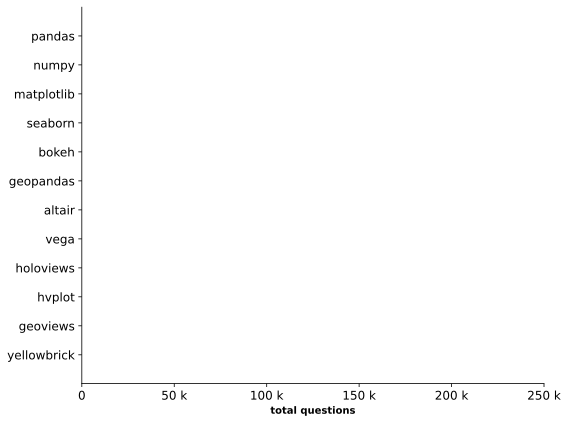

In [ ]:
%config InlineBackend.figure_formats = ['svg']
%matplotlib inline
bar_plot(questions_per_library)

In [ ]:
def generate_plot_text(ax):
  annotations = [
      ax.annotate(
          '', xy=(0, bar.get_y() + bar.get_height()/2),
          ha = 'left', va='center'
      ) for bar in ax.patches
  ]
  time_text = ax.text(
      0.9, 0.1, '', transform=ax.transAxes,
      fontsize=15, ha='center', va='center'
  )
  return annotations, time_text

In [ ]:
def update(frame, *, ax, df, annotations, time_text):
  data = df.loc[frame, :]

  #update bars
  for rect, text in zip(ax.patches, annotations):
    col = rect.get_label()
    if data[col]:
      rect.set_width(data[col])
      text.set_x(data[col])
      text.set_text(f' {data[col]:,.0f}')

    #update time
    time_text.set_text(frame.strftime('%b\n%Y'))

In [ ]:
from functools import partial

def bar_plot_init(questions_per_library):
  fig, ax = bar_plot(questions_per_library)
  annotations, time_text = generate_plot_text(ax)

  bar_plot_update = partial(
      update, ax=ax, df=questions_per_library,
      annotations=annotations, time_text=time_text
  )

  return fig, bar_plot_update

In [ ]:
fig, update_func = bar_plot_init(questions_per_library)

ani = FuncAnimation(
    fig, update_func, frames=questions_per_library.index, repeat=False
)
ani.save(
    '../media/stackoverflow_questions.mp4',
    writer='ffmpeg', fps=10, bitrate=100, dpi=300
)
plt.close()

In [ ]:
from IPython import display

display.Video(
    '../media/stackoverflow_questions.mp4', width=600, height=400,
    embed=True, html_attributes='controls muted autoplay'
)

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import ticker
from functools import partial
from matplotlib.animation import FuncAnimation



In [ ]:
subway = pd.read_csv(
    './data/NYC_subway_daily.csv', parse_dates=['Datetime'],
    index_col=['Borough', 'Datetime']

)
subway_daily = subway.unstack(0)
subway_daily.head()

Entries                                    Exits            \
Borough            Bk        Bx          M         Q        Bk        Bx   
Datetime                                                                   
2017-02-04   617650.0  247539.0  1390496.0  408736.0  417449.0  148237.0   
2017-02-05   542667.0  199078.0  1232537.0  339716.0  405607.0  139856.0   
2017-02-06  1184916.0  472846.0  2774016.0  787206.0  761166.0  267991.0   
2017-02-07  1192638.0  470573.0  2892462.0  790557.0  763653.0  270007.0   
2017-02-08  1243658.0  497412.0  2998897.0  825679.0  788356.0  275695.0   

                                 
Borough             M         Q  
Datetime                         
2017-02-04  1225689.0  279699.0  
2017-02-05  1033610.0  268626.0  
2017-02-06  2240027.0  537780.0  
2017-02-07  2325024.0  544828.0  
2017-02-08  2389534.0  559639.0

In [ ]:
manhattan_entries = subway_daily['Entries']['M']

In [ ]:
import numpy as np 
count_per_bin, bin_ranges = np.histogram(manhattan_entries, bins=30)

In [ ]:
def subway_histogram(data, bins, date_range):
  _, bin_ranges = np.histogram(data, bins=bins)

  weekday_mask = data.index.weekday < 5
  configs = [
      {'label': 'Weekend', 'mask': ~weekday_mask, 'ymax': 60},
      {'label': 'Weekend', 'mask': weekday_mask, 'ymax': 120}
  ]

  fig, axes = plt.subplots(1, 2, figsize = (8, 4), sharex = True)
  for ax, config in zip(axes, configs):
    _, _, config['hist'] = ax.hist(
        data[config['mask']].loc[date_range], bin_ranges, ec='black'
    )
    ax.xaxis.set_major_formatter(ticker.EngFormatter())
    ax.set(
        xlim = (0, None), ylim = (0, config['ymax']),
        xlabel=f'{config["label"]} Entries'
    )
    for spine in ['top', 'right']:
      ax.spines[spine].set_visible(False)

  axes[0].set_ylabel('Frequency')
  fig.suptitle('Histogram of Daily SSubway Entries in Manhattan')
  fig.tight_layout()

  return fig, axes, bin_ranges, configs

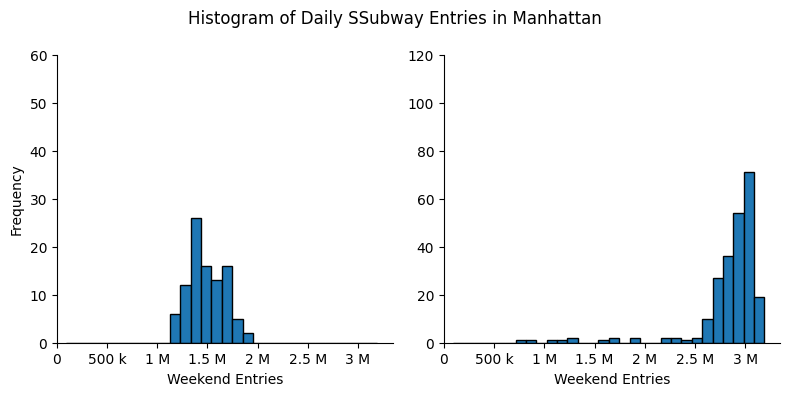

In [ ]:
_ = subway_histogram(manhattan_entries, bins=30, date_range='2017')

In [ ]:
def add_time_text(ax):
  time_text = ax.text(
      0.15, 0.9, '', transform=ax.transAxes,
      fontsize=15, ha='center', va='center'
  )
  return time_text

In [ ]:
def update(frame, *, data, configs, time_text, bin_ranges):
  artists = []

  time = frame.strftime('%b\n%Y')
  if time != time_text.get_text():
    time_text.set_text(time)
    artists.append(time_text)

  for config in configs:
    time_frame_mask = \
      (data.index > frame - pd.Timedelta(days=365)) & (data.index <= frame)
    counts, _ = np.histogram(
        data[time_frame_mask & config['mask']],
        bin_ranges
    )
    for count, rect in zip(counts, config['hist'].patches):
      if count != rect.get_height():
        rect.set_height(count)
        artists.append(rect)

  return artists                       

In [ ]:
def histogram_init(data, bins, initial_date_range):
  fig, axes, bin_ranges, configs = subway_histogram(data, bins, initial_date_range)

  update_func = partial(
      update, data=data, configs = configs,
      time_text=add_time_text(axes[0]),
      bin_ranges=bin_ranges
  )

  return fig, update_func

In [ ]:
fig, update_func = histogram_init(
    manhattan_entries, bins =30, initial_date_range=slice('2017', '2019-07')
)

ani = FuncAnimation(
    fig, update_func, frames=manhattan_entries['2019-08':'2021'].index,
    repeat=False, blit=True
)

ani.save(
    '../media/subway_entries_subplots.mp4',
    writer='ffmpeg', fps=30, bitrate=500, dpi=300
)

plt.close()

NameError: ignored

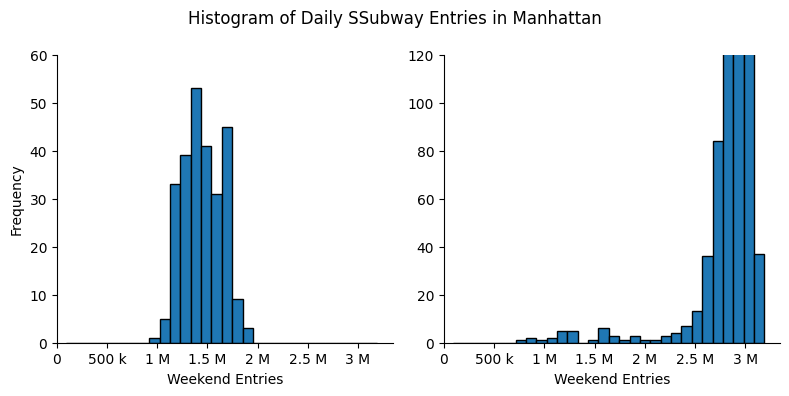

In [ ]:
fig, update_func = histogram_init(
    manhattan_entries, bins=30, initial_date_range=slice('2017', '2019-07')

)

ani = FunAnimation(
    fig, update_func, frames = manhattan_entries['2019-08':'2021'].index,
    repeat = False, blit = True
)
ani.save(
    '../media/subway_entries_subplots.mp4',
    writer = 'ffmpeg', fps=30, bitrate=500, dpi=300
)
plt.close()

In [ ]:
from IPython import display

display.Video(
    '../media/subway_entries_subplots.mp4', width =600, height=400,
    embed=True, html_attributes='controls muted autoplay'
)

In [3]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 52.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 73.9 MB/s eta 0:00:00


In [4]:
import geopandas as gpd
import pandas as pd

In [6]:


earthquakes = gpd.read_file('./data/earthquakes.geojson').assign(
    time = lambda x: pd.to_datetime(x.time, unit='ms'),
    month = lambda x: x.time.dt.month

)[['geometry', 'mag', 'time', 'month']]

earthquakes.shape

(188527, 4)

In [ ]:
earthquakes.head()

,geometry,mag,time,month
0,POINT Z (-67.12750 19.21750 12.00000),2.75,2020-01-01 00:01:56.590,1
1,POINT Z (-67.09010 19.07660 6.00000),2.55,2020-01-01 00:03:38.210,1
2,POINT Z (-66.85410 17.87050 6.00000),1.81,2020-01-01 00:05:09.440,1
3,POINT Z (-66.86360 17.89930 8.00000),1.84,2020-01-01 00:05:36.930,1
4,POINT Z (-66.86850 17.90660 8.00000),1.64,2020-01-01 00:09:20.060,1


In [11]:
!pip install geoviews

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 508.0/508.0 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 81.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 5.2 MB/s eta 0:00:00
  Created wheel for cartopy: filename=Cartopy-0.21.1-cp310-cp310-linux_x86_64.whl size=11102758 sha256=42e4e516c089dbf5cb913f5c91d8c028b93bb8ed9d819acd5c5550d4f172f365
  Stored in directory: /root/.cache/pip/wheels/30/b0/1a/1c1909e00c76653dc4e2ff48555257c0eb2d1698280c8d9955
Successfully built cartopy


In [12]:
import geoviews as gv
import geoviews.feature as gf
import holoviews as hv

gv.extension('matplotlib')

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [8]:
import calendar

def plot_earthquakes(data, month_num):
  points = gv.Points(
      data.query(f'month == {month_num}'),
      kdims = ['longitude', 'latitude'],
      vdims = ['mag']

  ).redim.range(mag=(-2,10), latitude=(-90,90))

  overlay = gf.land * gf.coastline * gf.borders * points

  return overlay.opts(
      gv.opts.Points(color='mag', cmap='fire_r', colorbar=True, alpha=0.75),
      gv.opts.Overlay(
          global_extent=False, title=f'{calendar.month_name[month_num]}', fontscale = 2
      )
  )

In [ ]:
plot_earthquakes(earthquakes, 1).opts(
    fig_inches=(6, 3), aspect = 2, fig_size = 250, fig_bounds=(0.07,0.05,0.87,0.95)
)

/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_boundary_lines_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


In [ ]:
frames = {
    month_num: plot_earthquakes(earthquakes, month_num)
    for month_num in range(1, 13)
}
holomap = hv.HoloMap(frames)

In [ ]:
hv.output(
    holomap.opts(
        fig_inches = (6, 3), aspect = 2, fig_size = 250,
        fig_bounds = (0.07, 0.05, 0.87, 0.95)
    ), holomap = 'gif', fps = 5
)

In [ ]:
hv.save(
    holomap.opts(
        fig_inches = (6, 3), aspect = 2, fig_size = 250,
        fig_bounds = (0.07, 0.05, 0.87, 0.95)
    ), 'earthquakes.gif', fps = 5
)

In [ ]:
import geopandas as gpd
import pandas as pd

earthquakes = gpd.read_file('./data/earthquakes.geojson').assign(
    time = lambda x: pd.to_datetime(x.time, unit = 'ms'),
    month = lambda x: x.time.dt.month
).dropna()

earthquakes.head()

,mag,place,time,tsunami,magType,geometry,month
0,2.75,"80 km N of Isabela, Puerto Rico",2020-01-01 00:01:56.590,0,md,POINT Z (-67.12750 19.21750 12.00000),1
1,2.55,"64 km N of Isabela, Puerto Rico",2020-01-01 00:03:38.210,0,md,POINT Z (-67.09010 19.07660 6.00000),1
2,1.81,"12 km SSE of Maria Antonia, Puerto Rico",2020-01-01 00:05:09.440,0,md,POINT Z (-66.85410 17.87050 6.00000),1
3,1.84,"9 km SSE of Maria Antonia, Puerto Rico",2020-01-01 00:05:36.930,0,md,POINT Z (-66.86360 17.89930 8.00000),1
4,1.64,"8 km SSE of Maria Antonia, Puerto Rico",2020-01-01 00:09:20.060,0,md,POINT Z (-66.86850 17.90660 8.00000),1


In [ ]:
!pip install cartopy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 58.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 36.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 6.1 MB/s eta 0:00:00
  Created wheel for cartopy: filename=Cartopy-0.21.1-cp310-cp310-linux_x86_64.whl size=11102740 sha256=6519436268396f64ecdb151d47812f415b9078d88d79fa677ed3e37e9de1ed85
  Stored in directory: /root/.cache/pip/wheels/30/b0/1a/1c1909e00c76653dc4e2ff48555257c0eb2d1698280c8d9955
Successfully built cartopy


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
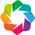

In [ ]:
from cartopy import crs
import geoviews as gv
import geoviews.feature as gf

gv.extension('bokeh')

In [ ]:
points = gv.Points(
    earthquakes,
    kdims = ['longitude', 'latitude'],
    vdims = ['month', 'place', 'tsunami', 'mag', 'magType']
)

points = points.redim.range(
    mag = (-2, 10), longitude = (-180, 180), latitude = (-90, 90)
)

In [ ]:
overlay = gf.land * gf.coastline * gf.borders * points.groupby('month')

In [ ]:
interactive_map = overlay.opts(
    gv.opts.Feature(projection = crs.PlateCarree()),
    gv.opts.Overlay(width = 700, height = 450),
    gv.opts.Points(color = 'mag', cmap = 'fire_r', colorbar = True, tools = ['hover'])
)

In [ ]:
import panel as pn
earthquake_viz = pn.panel(interactive_map, widget_location = 'bottom')

In [ ]:
earthquake_viz.embed()

NameError: ignored

In [ ]:
january_earthquakes = earthquakes.query('month == 1').assign(
    longitude = lambda x: x.geometry.x,
    latitude = lambda x: x.geometry.y
).drop(columns = ['month', 'geometry'])

In [ ]:
!pip install hvplot


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 21.8 MB/s eta 0:00:00


In [ ]:
import hvplot.pandas

In [ ]:
geo = january_earthquakes.hvplot(
    x = 'longitude', y = 'latitude', kind = 'points',
    color = 'mag', cmap = 'fire_r', clim = (-2, 10),
    tiles = 'CartoLight', geo = True, global_extent = True,
    xlabel = 'Longitude', ylabel = 'Latitude', title = 'January 2020 Earthquakes',
    frame_height = 450
)

In [ ]:
table = january_earthquakes.sort_values(['longitude', 'latitude']).hvplot(
    kind = 'table', width = 650, height = 450, title = 'Raw Data'
)

In [ ]:
layout = geo + table 

In [17]:
import holoviews as hv

selection = hv.link_selections.instance()
map_and_table_tabs = selection(layout).opts(tabs = True)

NameError: ignored

In [ ]:
map_and_table_tabs

In [ ]:
selection.filter(january_earthquakes).nlargest(3, 'mag')

In [8]:
import pandas as pd

In [9]:
import numpy as np

flight_stats = pd.read_csv(
    './data/T100_MARKET_ALL_CARRIER.zip',
    usecols = [
        'CLASS', 'REGION', 'UNIQUE_CARRIER_NAME', 'ORIGIN_CITY_NAME', 'ORIGIN',
        'DEST_CITY_NAME', 'DEST', 'PASSENGERS', 'FREIGHT', 'MAIL'
    ]
).rename(lambda x: x.lower(), axis = 1).assign(
    region = lambda x: x.region.replace({
        'D': 'Domestic', 'I': 'International', 'A': 'Atlantic',
        'L': 'Latin America', 'P': "Pacific", 'S': 'System'
    }),
    route = lambda x: np.where(
        x.origin < x.dest,
        x.origin + '-' + x.dest,
        x.dest + '-' + x.origin
    )
)

In [ ]:
flight_stats.head()

,passengers,freight,mail,unique_carrier_name,region,origin,origin_city_name,dest,dest_city_name,class,route
0,0.0,53185.0,0.0,Emirates,International,DXB,"Dubai, United Arab Emirates",IAH,"Houston, TX",G,DXB-IAH
1,0.0,9002.0,0.0,Emirates,International,DXB,"Dubai, United Arab Emirates",JFK,"New York, NY",G,DXB-JFK
2,0.0,2220750.0,0.0,Emirates,International,DXB,"Dubai, United Arab Emirates",ORD,"Chicago, IL",G,DXB-ORD
3,0.0,1201490.0,0.0,Emirates,International,IAH,"Houston, TX",DXB,"Dubai, United Arab Emirates",G,DXB-IAH
4,0.0,248642.0,0.0,Emirates,International,JFK,"New York, NY",DXB,"Dubai, United Arab Emirates",G,DXB-JFK


In [5]:
cities = [
    'Atlanta, GA', 'Chicago, IL', 'New York, NY', 'Los Angeles, CA',
    'Dallas/Fort Worth, TX', 'Denver, CO', 'Houston, TX',
    'San Francisco, CA', 'Seattle, WA', 'Orlando, FL'
]

top_airlines = [
    'American Airlines Inc.', 'Delta Air Lines Inc.', 'JetBlue Airways',
    'Southwest Airlines Co.', 'United Air Lines Inc.'
]

In [10]:
total_flight_stats = flight_stats.query(
    f'`class` == "F" and origin_city_name != dest_city_name'
    f' and origin_city_name.isin({cities}) and dest_city_name.isin({cities})' 
).groupby([
    'origin', 'origin_city_name', 'dest', 'dest_city_name'
])[['passengers', 'freight', 'mail']].sum().reset_index().query('passengers > 0')

In [ ]:
total_flight_stats.sample(10, random_state = 1)

,origin,origin_city_name,dest,dest_city_name,passengers,freight,mail
78,LGA,"New York, NY",DEN,"Denver, CO",589190.0,506023.0,293108.0
117,ORD,"Chicago, IL",SEA,"Seattle, WA",810594.0,1063463.0,2627325.0
31,DFW,"Dallas/Fort Worth, TX",MCO,"Orlando, FL",683700.0,187672.0,95570.0
5,ATL,"Atlanta, GA",LAX,"Los Angeles, CA",1121378.0,8707125.0,3267077.0
126,SEA,"Seattle, WA",LGA,"New York, NY",24.0,0.0,0.0
45,IAH,"Houston, TX",ATL,"Atlanta, GA",566369.0,367543.0,726670.0
14,DEN,"Denver, CO",HOU,"Houston, TX",305193.0,363119.0,0.0
44,HOU,"Houston, TX",SFO,"San Francisco, CA",1843.0,5523.0,0.0
73,LAX,"Los Angeles, CA",MDW,"Chicago, IL",277226.0,2022416.0,0.0
89,MCO,"Orlando, FL",DEN,"Denver, CO",594878.0,368516.0,138811.0


In [ ]:
chord = hv.Chord(
    total_flight_stats,
    kdims = ['origin', 'dest'],
    vdims = ['passengers', 'origin_city_name', 'dest_city_name', 'mail', 'freight']
)

In [ ]:
from bokeh.models import HoverTool

tooltips = {
    'Source': '@origin_city_name (@origin)',
    'Target': '@dest_city_name (@dest)',
    'Passengers': '@passengers{0,.}',
    'Mail': '@mail{0,.} lbs.',
    'Freight': '@freight{0,.} lbs.',
}
hover = HoverTool(tooltips = tooltips)

In [11]:
top_cities = cities[:5]

domestic_passenger_travel = flight_stats.query(
    'region == "Domestic" and `class` == "F" and origin_city_name != dest_city_name '
    f'and origin_city_name.isin({top_cities}) and dest_city_name.isin({top_cities})'
).groupby([
    'region', 'unique_carrier_name', 'route',
    'origin_city_name', 'dest_city_name'
]).passengers.sum().reset_index()

domestic_passenger_travel.head()

,region,unique_carrier_name,route,origin_city_name,dest_city_name,passengers
0,Domestic,Air Wisconsin Airlines Corp,ATL-ORD,"Atlanta, GA","Chicago, IL",915.0
1,Domestic,Air Wisconsin Airlines Corp,ATL-ORD,"Chicago, IL","Atlanta, GA",556.0
2,Domestic,Alaska Airlines Inc.,JFK-LAX,"Los Angeles, CA","New York, NY",265307.0
3,Domestic,Alaska Airlines Inc.,JFK-LAX,"New York, NY","Los Angeles, CA",257685.0
4,Domestic,Alaska Airlines Inc.,LAX-ORD,"Chicago, IL","Los Angeles, CA",48269.0


In [12]:
domestic_passenger_travel.unique_carrier_name.replace(
    '^(?!' + '|'.join(top_airlines) + ').*$',
    'Other Airlines',
    regex = True, inplace = True
)

In [ ]:
domestic_passenger_travel.groupby('unique_carrier_name').passengers.sum().div(
    domestic_passenger_travel.passengers.sum()
)

unique_carrier_name
American Airlines Inc.    0.337186
Delta Air Lines Inc.      0.312187
JetBlue Airways           0.049500
Other Airlines            0.120544
Southwest Airlines Co.    0.079074
United Air Lines Inc.     0.101509
Name: passengers, dtype: float64

In [1]:
def get_edges(data, *, source_col, target_col):
  aggregated = data.groupby([source_col, target_col]).passengers.sum()
  return aggregated.reset_index().rename(
      columns = {source_col: 'source', target_col: 'target'}
  ).query('passengers > 0')

In [13]:
carrier_edges = get_edges(
    domestic_passenger_travel,
    source_col = 'region',
    target_col = 'unique_carrier_name'
).replace('Domestic', 'Top Routes')

carrier_edges

,source,target,passengers
0,Top Routes,American Airlines Inc.,9426060.0
1,Top Routes,Delta Air Lines Inc.,8727210.0
2,Top Routes,JetBlue Airways,1383776.0
3,Top Routes,Other Airlines,3369815.0
4,Top Routes,Southwest Airlines Co.,2210533.0
5,Top Routes,United Air Lines Inc.,2837682.0


In [14]:
carrier_to_route_edges = get_edges(
    domestic_passenger_travel,
    source_col = 'unique_carrier_name',
    target_col = 'route'
)

carrier_to_route_edges.sample(10, random_state = 1)

,source,target,passengers
39,Other Airlines,DFW-LGA,157366.0
41,Other Airlines,JFK-LAX,523222.0
2,American Airlines Inc.,ATL-LAX,294304.0
48,Southwest Airlines Co.,ATL-MDW,498481.0
50,Southwest Airlines Co.,LAX-MDW,558574.0
44,Other Airlines,LAX-ORD,378552.0
33,Other Airlines,ATL-LAX,146882.0
35,Other Airlines,ATL-MDW,1201.0
40,Other Airlines,DFW-ORD,241147.0
27,JetBlue Airways,DFW-JFK,140.0


In [15]:
all_edges = pd.concat([carrier_edges, carrier_to_route_edges]).assign(
    passengers = lambda x: x.passengers / 1e6
)

In [26]:
import holoviews.plotting.bokeh

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
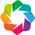

In [22]:
import holoviews as hv
hv.extension('bokeh')  # Replace 'bokeh' with the desired plotting backend




In [29]:
sankey = hv.Sankey(
    all_edges,
    kdims = ['source', 'target'],
    vdims = hv.Dimension('passengers', unit = 'M')
).opts(
    labels = 'index', label_position = 'right', cmap = 'Set1', #node config
    edge_color = 'lightgray', #edge config
    width = 750, height = 600, #plot size config
    title = 'Travel Between the Top 5 Cities in 2019'
)

In [31]:
sankey

:Sankey   [source,target]   (passengers)